<center><img src="https://github.com/insaid2018/Term-1/blob/master/Images/INSAID_Full%20Logo.png?raw=true" width="240" height="100" /></center>

# CDF Capstone Project

---
# **Table of Contents**
---
**1.** [**Introduction**](#Section1)<br>

**2.** [**Problem Statement**](#Section2)<br>

**3.** [**Installing & Importing Libraries**](#Section3)<br>
  - **3.1** [**Installing Libraries**](#Section31)
  - **3.2** [**Upgrading Libraries**](#Section32)
  - **3.3** [**Importing Libraries**](#Section33)

**4.** [**Data Acquisition & Information**](#Section4)<br>
  - **4.1** [**Data Acquisition**](#Section41)
   - **4.1.1** [**Importing Events Dataset from CSV file**](#Section411)
   - **4.1.2** [**Importing Gender_age & Brand_model Dataset from MySQL**](#Section412)
  - **4.2** [**Data Information**](#Section42)
   - **4.2.1** [**Data Information for Events Dataset**](#Section421)
   - **4.2.2** [**Data Information for Gender_age Dataset**](#Section422)
   - **4.2.3** [**Data Information for Brand_model Dataset**](#Section423)

**5.** [**Data Pre-processing**](#Section5)<br>
  - **5.1** [**Filtering Events Dataset by States**](#Section51)
  - **5.2** [**Merging all three datasets**](#Section52)
  - **5.3** [**Pre-Profiling Report**](#Section53)
  - **5.4** [**Handling of Missing Data**](#Section54)<br>
  - **5.5** [**Handling Chinese characters in the Dataset**](#Section55)<br>
  - **5.6** [**Checking correctness of Geographical Data**](#Section56)<br>
  - **5.7** [**Handling incorrect datatypes**](#Section57)<br>
  - **5.8** [**Removing unwanted columns**](#Section58)<br>
  - **5.9** [**Feature Engineering.**](#Section59)<br>
  - **5.10** [**Post Processing Report**](#Section510)<br>

**6.** [**Exploratory Data Analysis**](#Section6)<br>

**7.** [**Summarization**](#Section7)<br>
  - **7.1** [**Conclusion**](#Section71)<br>
  - **7.2** [**Actionable Insights**](#Section72)<br>

---
<a name = Section1></a>
# **1. Introduction**
---


<center><img src="" /></center>

InsaidTelecom, one of the leading telecom players, understands that customizing offering is very important for its business to stay competitive.
Currently, InsaidTelecom is seeking to leverage behavioral data from more than 60% of the 50 million mobile devices active daily in India to help its clients better understand and interact with their audiences.

In this consulting assignment, Insaidians are expected to build a dashboard to understand user's demographic characteristics based on their mobile usage, geolocation, and mobile device properties.

Doing so will help millions of developers and brand advertisers around the world pursue data-driven marketing efforts which are relevant to their users and catered to their preferences.

---
<a name = Section2></a>
# **2. Problem Statement**
---


<center><img src="" /></center>

---
<a name = Section3></a>
# **3. Installing & Importing Libraries**
---

<a name = Section31></a>
### **3.1 Installing Libraries**

In [1]:
#!pip install -q datascience                   # Package that is required by pandas profiling
#!pip install -q pandas-profiling              # Library to generate basic statistics about data
#!pip install -q yellowbrick                   # Toolbox for Measuring Machine Performance 
#pip install mysql-connector-python            # to establish connection to MySQL database
#!pip install deep-translator                  # package for Google Translator
#!pip install folium                           # for plotting points on map

<a name = Section32></a>
### **3.2 Upgrading Libraries**

- **After upgrading** the libraries, you need to **restart the runtime** to make the libraries in sync. 

- Make sure not to execute the cell above (3.1) and below (3.2) again after restarting the runtime.

In [2]:
#!pip install -q --upgrade pandas-profiling
#!pip install -q --upgrade yellowbrick

<a name = Section33></a>
### **3.3 Importing Libraries**

In [3]:
#-------------------------------------------------------------------------------------------------------------------------------
import pandas as pd                                                 # Importing for panel data analysis
from pandas_profiling import ProfileReport                          # Import Pandas Profiling (To generate Univariate Analysis) 
pd.set_option('display.max_columns', None)                          # Unfolding hidden features if the cardinality is high      
pd.set_option('display.max_colwidth', None)                         # Unfolding the max feature width for better clearity      
pd.set_option('display.max_rows', None)                             # Unfolding hidden data points if the cardinality is high
pd.set_option('mode.chained_assignment', None)                      # Removing restriction over chained assignments operations
pd.set_option('display.float_format', lambda x: '%.5f' % x)         # To suppress scientific notation over exponential values
#-------------------------------------------------------------------------------------------------------------------------------
import numpy as np                                                  # Importing package numpys (For Numerical Python)
from scipy.stats import randint as sp_randint                       # for initializing random integer values
#-------------------------------------------------------------------------------------------------------------------------------
import matplotlib.pyplot as plt                                     # Importing pyplot interface using matplotlib
from matplotlib.pylab import rcParams                               # Backend used for rendering and GUI integration                                               
import seaborn as sns                                               # Importin seaborm library for interactive visualization
%matplotlib inline
#-------------------------------------------------------------------------------------------------------------------------------
from sklearn.metrics import accuracy_score                          # For calculating the accuracy for the model
from sklearn.metrics import precision_score                         # For calculating the Precision of the model
from sklearn.metrics import recall_score                            # For calculating the recall of the model
from sklearn.metrics import precision_recall_curve                  # For precision and recall metric estimation
from sklearn.metrics import confusion_matrix                        # For verifying model performance using confusion matrix
from sklearn.metrics import f1_score                                # For Checking the F1-Score of our model  
from sklearn.metrics import roc_curve                               # For Roc-Auc metric estimation
#-------------------------------------------------------------------------------------------------------------------------------
from sklearn.model_selection import train_test_split                # To split the data in training and testing part     
from sklearn.feature_selection import SelectFromModel               # To perform Feature Selection over model
from yellowbrick.model_selection import FeatureImportances          # To retrieve Feature Importances over model
#-------------------------------------------------------------------------------------------------------------------------------
import warnings                                                     # Importing warning to disable runtime warnings
warnings.filterwarnings("ignore")                                   # Warnings will appear only once
#-------------------------------------------------------------------------------------------------------------------------------
import mysql.connector as connection
#-------------------------------------------------------------------------------------------------------------------------------
from deep_translator import GoogleTranslator                        #Importing Google Translator
#-------------------------------------------------------------------------------------------------------------------------------
import re                                                           #Importing Python built-in package for Regular Expression
#--------------------------------------------------------------------------------------------------------------------------------
import folium                                                       #Importing Folium package for plotting the coordinates on a map

---
<a name = Section4></a>
# **4. Data Acquisition & Information**
---

<a name = Section41></a>
### **4.1 Data Acquisition**

- In this section we will read the datasets from the various sources available.

<a name = Section411></a>
#### **4.1.1 Importing 1st dataset - 'events_data' from a csv file**

- When a user uses mobile on INSAID Telecom network, the event gets logged in this data. Each event has an event id, location (lat/long), and the event corresponds to frequency of mobile usage. Timestamp tells when the user is using the mobile.

In [4]:
# Reading the data from the events data csv file
df_events_data = pd.read_csv('C:/Users/supadhyaya8/OneDrive - DXC Production/Documents/cdf/events_data.csv')
df_events_data.head()

,event_id,device_id,timestamp,longitude,latitude,city,state
0,2765368,2973347786994914304.00000,2016-05-07 22:52:05,77.22568,28.73014,Delhi,Delhi
1,2955066,4734221357723754496.00000,2016-05-01 20:44:16,88.38836,22.66033,Calcutta,WestBengal
2,605968,-3264499652692492800.00000,2016-05-02 14:23:04,77.25681,28.75791,Delhi,Delhi
3,448114,5731369272434022400.00000,2016-05-03 13:21:16,80.34361,13.15333,Chennai,TamilNadu
4,665740,338888002570799936.00000,2016-05-06 03:51:05,85.99774,23.84261,Bokaro,Jharkhand


In [5]:
#checking the shape of the dataset
df_events_data.shape

(3252950, 7)

<a name = Section411></a>
#### **4.1.2 Importing 2nd & 3rd dataset - 'gender_age_train' & 'phone_brand_device_model' from MySQL database**

- gender_age_train           :- Device_ids and their respective user gender, age and age_group
- phone_brand_device_model   :- device ids, brand, and device's model.

In [6]:
#Downloading the data from the MySQL database for gender_age_train & phone_brand_device_model onto Python by connecting to the below provided MySQL instance.
try:
    mydb = connection.connect(host="cpanel.insaid.co", database = 'Capstone1',user="student", passwd="student",use_pure=True)
    query1 = "Select * from gender_age_train;"
    query2 = "Select * from phone_brand_device_model;"
    df_gender_age = pd.read_sql(query1,mydb)
    df_brand_model = pd.read_sql(query2,mydb)
    mydb.close() #close the connection
except Exception as e:
    mydb.close()
    print(str(e))

- getting the head for the gender_age dataset

In [7]:
df_gender_age.head(10)

,device_id,gender,age,group
0,-8076087639492063270,M,35,M32-38
1,-2897161552818060146,M,35,M32-38
2,-8260683887967679142,M,35,M32-38
3,-4938849341048082022,M,30,M29-31
4,245133531816851882,M,30,M29-31
5,-1297074871525174196,F,24,F24-26
6,236877999787307864,M,36,M32-38
7,-8098239495777311881,M,38,M32-38
8,176515041953473526,M,33,M32-38
9,1596610250680140042,F,36,F33-42


In [8]:
df_gender_age.shape

(74645, 4)

- getting the head for the brand_model dataset

In [9]:
df_brand_model.head()

,device_id,phone_brand,device_model
0,1877775838486905855,vivo,Y13
1,-3766087376657242966,小米,V183
2,-6238937574958215831,OPPO,R7s
3,8973197758510677470,三星,A368t
4,-2015528097870762664,小米,红米Note2


In [10]:
df_brand_model.shape

(87726, 3)

In [11]:
#df_gender_age.to_csv('gender_age_train.csv')

In [12]:
#df_brand_model.to_csv('phone_brand_device_model.csv')

<a name = Section42></a>
### **4.2 Data Information**

- In this section we will see the **information about the types of features**.

<a name = Section421></a>
#### **4.2.1 Data Information for Events Dataset**

- In this section we will see the **information about the types of features for events dataset**.

In [13]:
df_events_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3252950 entries, 0 to 3252949
Data columns (total 7 columns):
 #   Column     Dtype  
---  ------     -----  
 0   event_id   int64  
 1   device_id  float64
 2   timestamp  object 
 3   longitude  float64
 4   latitude   float64
 5   city       object 
 6   state      object 
dtypes: float64(3), int64(1), object(3)
memory usage: 173.7+ MB


In [14]:
#Checking if null values are present in events dataset
df_events_data.isnull().sum()

event_id       0
device_id    453
timestamp      0
longitude    423
latitude     423
city           0
state        377
dtype: int64

**Observations for Events Dataset:**
1. There are __3252950 records and 7 features__ in the events dataset.
2. There are __453 missing values__ for deviec_id.
3. Datatype of __device_id is float__
4. __Timestamp__ is object to be converted __to datetime.__
5. longitude and latitude have __423 missing values.__
6. State has __377 missing values.__
7. There are __4 numerical features, 2 categorical features and a timestamp.__

<a name = Section422></a>
#### **4.2.2 Data Information for Gender_age Dataset**

- In this section we will see the **information about the types of features for gender_age dataset**.

In [15]:
df_gender_age.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74645 entries, 0 to 74644
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   device_id  74645 non-null  int64 
 1   gender     74645 non-null  object
 2   age        74645 non-null  int64 
 3   group      74645 non-null  object
dtypes: int64(2), object(2)
memory usage: 2.3+ MB


In [16]:
df_gender_age['device_id'].nunique()

74645

**Observations for Gender_age Dataset:**
1. There are __74645 records and 4 features__.
2. There are __no missing values__.
3. __Correct Datatype__ of all the features.
4. There are __2 numerical features, 2 categorical features.__

<a name = Section423></a>
#### **4.2.3 Data Information for Brand_Model Dataset**

- In this section we will see the **information about the types of features for brand_model dataset**.

In [17]:
df_brand_model.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87726 entries, 0 to 87725
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   device_id     87726 non-null  int64 
 1   phone_brand   87726 non-null  object
 2   device_model  87726 non-null  object
dtypes: int64(1), object(2)
memory usage: 2.0+ MB


In [18]:
df_brand_model['device_id'].nunique()

87726

**Observations for Brand_model Dataset:**
1. There are __87726 records and 3 features__.
2. There are __no missing values__.
3. __Correct Datatype__ of all the features.
4. There is __1 numerical feature, 2 categorical features.__

<a name = Section5></a>

---
# **5. Data Pre-Processing**
---

<a name = Section51></a>
### **5.1 Filtering the events dataset by states (WestBengal, Karnataka, Bihar, Punjab,Gujarat, Kerala)**


- For consulting, team is to focus on 6 states: WestBengal, Karnataka, Bihar, Punjab,Gujarat and Kerala.
- We observed that Events dataset has 377 missing values in 'state' column.
- So, first we have to handle these missing values before we filter the dataset by states.

In [19]:
df_events_data[df_events_data['state'].isnull()].sample(5)

,event_id,device_id,timestamp,longitude,latitude,city,state
2576289,1778466,1177845145394796800.00000,2016-05-04 16:47:55,75.84836,26.95357,Jaipur,NaN
2795463,762084,-5858653205052383232.00000,2016-05-01 08:14:50,88.61942,25.48446,Gangarampur,NaN
3200276,3245808,-8340098378141155328.00000,2016-05-06 19:17:16,77.30599,28.68898,Delhi,NaN
1023419,1797214,2601606673970940928.00000,2016-05-07 09:02:10,73.87071,18.61934,Pune,NaN
2654382,3034089,3848287267880940544.00000,2016-05-04 19:23:44,75.83631,26.93273,Jaipur,NaN


#### Handling the missing value in 'state' column for WestBengal, Karnataka, Bihar, Punjab,Gujarat, Kerala

In [20]:
# finding the unique states
df_events_data['state'].unique()

array(['Delhi', 'WestBengal', 'TamilNadu', 'Jharkhand', 'AndhraPradesh',
       'Maharashtra', 'Gujarat', 'Kerala', 'MadhyaPradesh', 'Karnataka',
       'Rajasthan', 'Orissa', 'Punjab', 'UttarPradesh', 'Nagaland',
       'Haryana', 'Telangana', 'Chhattisgarh', 'Bihar', 'JammuandKashmir',
       'Assam', 'Goa', 'Mizoram', 'Tripura', 'Uttaranchal', nan,
       'Pondicherry', 'Manipur', 'Meghalaya', 'ArunachalPradesh',
       'HimachalPradesh', 'Chandigarh', 'AndamanandNicobarIslands'],
      dtype=object)

In [21]:
#finding out the cities for the missing state so that we can fill the missing states from the corresponding city.
(df_events_data['city'][df_events_data['state'].isnull()]).unique()

array(['Pune', 'Visakhapatnam', 'Indore', 'Chennai', 'Delhi',
       'Channapatna', 'Jaipur', 'Gangarampur', 'Arambagh'], dtype=object)

 - We will fill the missing states for these 3 cities:
 - Channapatna -> Karnataka
 - Gangarampur -> WestBengal
 - Arambagh -> WestBengal

#### Filling the missing values for the states

In [22]:
#Replacing the nan values in state with Karnataka where city is Channapatna
df_events_data.loc[(df_events_data['city'] == 'Channapatna') & (df_events_data['state'].isnull()), 'state'] = 'Karnataka'

In [23]:
#Replacing the nan values in state with WestBengal where city is Gangarampur
df_events_data.loc[(df_events_data['city'] == 'Gangarampur') & (df_events_data['state'].isnull()), 'state'] = 'WestBengal'

In [24]:
#Replacing the nan values in state with WestBengal where city is Arambagh
df_events_data.loc[(df_events_data['city'] == 'Arambagh') & (df_events_data['state'].isnull()), 'state'] = 'WestBengal'

In [25]:
#Re-checking if events dataset contains any missing states for WestBengal, Karnataka, Bihar, Punjab,Gujarat and Kerala 
#by checking the list of cities for the missing states.
(df_events_data['city'][df_events_data['state'].isnull()]).unique()

array(['Pune', 'Visakhapatnam', 'Indore', 'Chennai', 'Delhi', 'Jaipur'],
      dtype=object)

In [26]:
df_events_data['state'].isnull().sum()

321

- Only 56 missing states belonged to WestBengal, Karnataka, Bihar, Punjab,Gujarat, Kerala

#### Filtering the events database by states (WestBengal, Karnataka, Bihar, Punjab,Gujarat, Kerala)

In [27]:
df_events_data_filtered = df_events_data[df_events_data['state'].isin(['WestBengal', 'Karnataka', 'Bihar', 'Punjab','Gujarat', 'Kerala'])]

In [28]:
df_events_data_filtered.head()

,event_id,device_id,timestamp,longitude,latitude,city,state
1,2955066,4734221357723754496.00000,2016-05-01 20:44:16,88.38836,22.66033,Calcutta,WestBengal
28,769546,-1817502319478569728.00000,2016-05-01 14:07:23,88.37181,22.66285,Calcutta,WestBengal
30,1750603,-5598137337131307008.00000,2016-05-05 15:47:03,70.21268,23.11837,Gandhidham,Gujarat
31,3085968,-3808296883972395520.00000,2016-05-07 01:25:47,75.51302,11.81237,Thalassery,Kerala
39,1407594,-2995507760806350336.00000,2016-05-03 20:01:35,77.80519,13.53330,ChikBallapur,Karnataka


In [29]:
df_events_data_filtered.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 422971 entries, 1 to 3252921
Data columns (total 7 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   event_id   422971 non-null  int64  
 1   device_id  422923 non-null  float64
 2   timestamp  422971 non-null  object 
 3   longitude  422929 non-null  float64
 4   latitude   422929 non-null  float64
 5   city       422971 non-null  object 
 6   state      422971 non-null  object 
dtypes: float64(3), int64(1), object(3)
memory usage: 25.8+ MB


In [30]:
#checking null values in the filtered dataset
df_events_data_filtered.isnull().sum()

event_id      0
device_id    48
timestamp     0
longitude    42
latitude     42
city          0
state         0
dtype: int64

**Observations for the filtered event dataset:**
- There are __422971 records and 7 features__ in the filtered events dataset.
- __event_id, timestamp, city and state__ columns have __no missing values.__
- __device_id__ has __48 missing values__
- __longitude and latitude__ have __42 missing values.__
- __Timestamp is object to be converted to datetime.__
- __Data types__ for all other columns are correct.

<a name = Section52></a>
### **5.2 Merging all 3 datasets**

- Here, we will map all the records of **_events_** dataset with **_gender_age_** and **_brand_model_** datasets to get the demographic details and the brand model details of the users.
- We will create a new merged dataframe which will be used for further analysis.
- __Merging of the datasets will happen on the common column _device id_.__
- So, first we need to fill in the missing values for the _device id_ in the filtered events dataset.

#### Handling missing device_ids in the filtered dataset

In [31]:
df_events_data_filtered[df_events_data_filtered['device_id'].isnull()].groupby(['longitude', 'latitude','city','state']).count()

,,,,event_id,device_id,timestamp
longitude,latitude,city,state,,,
70.68639,21.79069,Jetpur,Gujarat,16,0,16
73.16934,21.19428,Bardoli,Gujarat,16,0,16
75.99255,31.56175,Hoshiarpur,Punjab,16,0,16


- We see that there are 3 device_ids whose values are missing:
- They can be mapped as:
  - 1st device id where longitude = 73.16934, latitude = 21.19428, city= Bardoli , state=Gujarat
  - 2nd device id where longitude = 70.68639, latitude = 21.79069, city= Jetpur, state=Gujarat
  - 3rd device id where longitude = 75.99255, latitude = 31.56175, city= Hoshiarpur, state=Punjab

In [32]:
# get the 1st device id
df_events_data_filtered[(df_events_data_filtered['longitude'] == 73.16934) & (df_events_data_filtered['latitude'] == 21.19428)]

,event_id,device_id,timestamp,longitude,latitude,city,state


In [33]:
# get the 1st device id where longitude = 73.16934, latitude = 21.19428, city= Bardoli , state=Gujarat
df_events_data_filtered[(df_events_data_filtered['city'] == 'Bardoli') & (df_events_data_filtered['state'] == 'Gujarat')].groupby(['device_id','longitude', 'latitude','city','state']).count()

,,,,,event_id,timestamp
device_id,longitude,latitude,city,state,,
-8939375088504041472.00000,73.20107,21.17746,Bardoli,Gujarat,15,15
-8245807954961570816.00000,73.15158,21.19418,Bardoli,Gujarat,1,1
-8215770519233685504.00000,73.16934,21.19428,Bardoli,Gujarat,381,381
-8101478099587991552.00000,73.16179,21.20450,Bardoli,Gujarat,5,5
-8022320605308700672.00000,73.20153,21.19053,Bardoli,Gujarat,18,18
-7629548547563755520.00000,73.20758,21.15599,Bardoli,Gujarat,8,8
-7046882659286756352.00000,73.21763,21.14622,Bardoli,Gujarat,1,1
-6624996692128278528.00000,73.15566,21.18198,Bardoli,Gujarat,13,13
-6313122852748910592.00000,73.13923,21.20802,Bardoli,Gujarat,84,84


- 1st device id is __-8215770519233685504__ where longitude = 73.16934, latitude = 21.19428, city= Bardoli , state=Gujarat

In [34]:
# get the 2nd device id where longitude = 70.68639, latitude = 21.79069, city= Jetpur, state=Gujarat
df_events_data_filtered[(df_events_data_filtered['city'] == 'Jetpur') & (df_events_data_filtered['state'] == 'Gujarat')].groupby(['device_id','longitude', 'latitude','city','state']).count()

,,,,,event_id,timestamp
device_id,longitude,latitude,city,state,,
-9100626844458295296.00000,70.68467,21.79341,Jetpur,Gujarat,32,32
-7864383677585044480.00000,70.62907,21.82055,Jetpur,Gujarat,95,95
-7356791296642819072.00000,70.68620,21.80623,Jetpur,Gujarat,1,1
-6941872424033244160.00000,70.62482,21.80541,Jetpur,Gujarat,4,4
-4748170714083747840.00000,70.62804,21.76449,Jetpur,Gujarat,9,9
-4619283383535598592.00000,70.68497,21.78174,Jetpur,Gujarat,17,17
-4161076139992630784.00000,70.63390,21.82504,Jetpur,Gujarat,26,26
-4109861778213652480.00000,70.64444,21.81232,Jetpur,Gujarat,2,2
-3642392870862093312.00000,70.67585,21.82392,Jetpur,Gujarat,22,22


 - 2nd device id is __-1688015122502424064__ where longitude = 70.68639, latitude = 21.79069, city= Jetpur, state=Gujarat

In [35]:
df_events_data_filtered[(df_events_data_filtered['city'] == 'Hoshiarpur') & (df_events_data_filtered['state'] == 'Punjab')].groupby(['device_id','longitude', 'latitude','city','state']).count()

,,,,,event_id,timestamp
device_id,longitude,latitude,city,state,,
-9179704438540888064.00000,76.00749,31.56383,Hoshiarpur,Punjab,5,5
-9003299201851031552.00000,75.96806,31.57004,Hoshiarpur,Punjab,1,1
-7959352580287944704.00000,75.97433,31.60916,Hoshiarpur,Punjab,12,12
-7516713034711112704.00000,75.92446,31.60512,Hoshiarpur,Punjab,16,16
-6314072935617405952.00000,75.93961,31.55397,Hoshiarpur,Punjab,31,31
-6016575845341766656.00000,75.95764,31.60668,Hoshiarpur,Punjab,11,11
-5583822054383365120.00000,75.95360,31.60232,Hoshiarpur,Punjab,2,2
-4252602101177080320.00000,75.99204,31.62383,Hoshiarpur,Punjab,10,10
-3923551471103946240.00000,75.96350,31.61652,Hoshiarpur,Punjab,113,113


- 3rd device id is __1750778632182066944__ where longitude = 75.99255, latitude = 31.56175, city= Hoshiarpur, state=Punjab

#### Filling the missing values for device ids

In [36]:
#Replacing the missing device id for 1st missing device
df_events_data_filtered.loc[((df_events_data_filtered['city'] == 'Bardoli') & (df_events_data_filtered['state'] == 'Gujarat')) & (df_events_data['device_id'].isnull()), 'device_id'] = -8215770519233685504

In [37]:
#Replacing the missing device id for 2nd missing device
df_events_data_filtered.loc[((df_events_data_filtered['city'] == 'Jetpur') & (df_events_data_filtered['state'] == 'Gujarat')) & (df_events_data['device_id'].isnull()), 'device_id'] = -1688015122502424064

In [38]:
#Replacing the missing device id for 3rd missing device
df_events_data_filtered.loc[((df_events_data_filtered['city'] == 'Hoshiarpur') & (df_events_data_filtered['state'] == 'Punjab')) & (df_events_data['device_id'].isnull()), 'device_id'] = 1750778632182066944

In [39]:
df_events_data_filtered.isnull().sum()

event_id      0
device_id     0
timestamp     0
longitude    42
latitude     42
city          0
state         0
dtype: int64

#### Merging all the 3 datasets on device_id
- Datatype of device_id is inconsistent among the 3 datasets which needs to be corrected first.

- **1st Merging the filtered event dataset with gender_age dataset on** _device_id_
   - First, we need to convert the data type of __device_id__ in gender_age dataset to __float__

In [40]:
df_gender_age['device_id'] = df_gender_age['device_id'].astype(df_events_data_filtered['device_id'].dtype)

In [41]:
df_gender_age.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74645 entries, 0 to 74644
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   device_id  74645 non-null  float64
 1   gender     74645 non-null  object 
 2   age        74645 non-null  int64  
 3   group      74645 non-null  object 
dtypes: float64(1), int64(1), object(2)
memory usage: 2.3+ MB


- **Merging the two datasets**

In [42]:
df_events_gender = pd.merge(df_events_data_filtered, df_gender_age, on='device_id', how='left')
df_events_gender.head()

,event_id,device_id,timestamp,longitude,latitude,city,state,gender,age,group
0,2955066,4734221357723754496.00000,2016-05-01 20:44:16,88.38836,22.66033,Calcutta,WestBengal,M,30,M29-31
1,769546,-1817502319478569728.00000,2016-05-01 14:07:23,88.37181,22.66285,Calcutta,WestBengal,F,43,F43+
2,1750603,-5598137337131307008.00000,2016-05-05 15:47:03,70.21268,23.11837,Gandhidham,Gujarat,M,23,M23-26
3,3085968,-3808296883972395520.00000,2016-05-07 01:25:47,75.51302,11.81237,Thalassery,Kerala,M,24,M23-26
4,1407594,-2995507760806350336.00000,2016-05-03 20:01:35,77.80519,13.53330,ChikBallapur,Karnataka,M,29,M29-31


In [43]:
df_events_gender.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 422971 entries, 0 to 422970
Data columns (total 10 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   event_id   422971 non-null  int64  
 1   device_id  422971 non-null  float64
 2   timestamp  422971 non-null  object 
 3   longitude  422929 non-null  float64
 4   latitude   422929 non-null  float64
 5   city       422971 non-null  object 
 6   state      422971 non-null  object 
 7   gender     422971 non-null  object 
 8   age        422971 non-null  int64  
 9   group      422971 non-null  object 
dtypes: float64(3), int64(2), object(5)
memory usage: 35.5+ MB


- **2nd Merging the event_gender dataset with brand_model dataset on** _device_id_.
   - First, we need to convert the data type of __device_id__ in brand_model dataset to __float__

In [44]:
df_brand_model['device_id'] = df_brand_model['device_id'].astype(df_events_gender['device_id'].dtype)

In [45]:
df_brand_model.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87726 entries, 0 to 87725
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   device_id     87726 non-null  float64
 1   phone_brand   87726 non-null  object 
 2   device_model  87726 non-null  object 
dtypes: float64(1), object(2)
memory usage: 2.0+ MB


- **Merging the two datasets to get final merged dataset**

In [46]:
df_final_merged = pd.merge(df_events_gender, df_brand_model, on='device_id', how='left')
df_final_merged.head()

,event_id,device_id,timestamp,longitude,latitude,city,state,gender,age,group,phone_brand,device_model
0,2955066,4734221357723754496.00000,2016-05-01 20:44:16,88.38836,22.66033,Calcutta,WestBengal,M,30,M29-31,vivo,X5M
1,769546,-1817502319478569728.00000,2016-05-01 14:07:23,88.37181,22.66285,Calcutta,WestBengal,F,43,F43+,OPPO,R819T
2,1750603,-5598137337131307008.00000,2016-05-05 15:47:03,70.21268,23.11837,Gandhidham,Gujarat,M,23,M23-26,魅族,MX3
3,3085968,-3808296883972395520.00000,2016-05-07 01:25:47,75.51302,11.81237,Thalassery,Kerala,M,24,M23-26,vivo,X5L
4,1407594,-2995507760806350336.00000,2016-05-03 20:01:35,77.80519,13.53330,ChikBallapur,Karnataka,M,29,M29-31,OPPO,R7 Plus


In [47]:
df_final_merged.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 422971 entries, 0 to 422970
Data columns (total 12 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   event_id      422971 non-null  int64  
 1   device_id     422971 non-null  float64
 2   timestamp     422971 non-null  object 
 3   longitude     422929 non-null  float64
 4   latitude      422929 non-null  float64
 5   city          422971 non-null  object 
 6   state         422971 non-null  object 
 7   gender        422971 non-null  object 
 8   age           422971 non-null  int64  
 9   group         422971 non-null  object 
 10  phone_brand   422971 non-null  object 
 11  device_model  422971 non-null  object 
dtypes: float64(3), int64(2), object(7)
memory usage: 42.0+ MB


In [48]:
df_final_merged.isnull().sum()

event_id         0
device_id        0
timestamp        0
longitude       42
latitude        42
city             0
state            0
gender           0
age              0
group            0
phone_brand      0
device_model     0
dtype: int64

#### Observations of the final merged dataset:
- There are __422971 records and 12 features.__
- __longitude and latitude__ columns have 42 missing values each. There are __84 missing cells.__
- __Timestamp is object__ type needs to be converted __to datetime.__
- Data types for all other columns are correct.
- There are __6 categorical columns, 5 numerical columns and a timestamp.__

In [49]:
df_final_merged.describe()

,event_id,device_id,longitude,latitude,age
count,422971.00000,422971.00000,422929.00000,422929.00000,422971.00000
mean,1635553.21051,54332593871695992.00000,82.33530,20.79314,31.44556
std,930915.34686,5330461509042279424.00000,6.38155,5.42450,9.78804
min,20881.00000,-9221066489596332032.00000,12.56740,8.41244,11.00000
25%,822921.00000,-4582571963008606720.00000,76.55060,15.20491,25.00000
50%,1632956.00000,124460672713006880.00000,85.51903,22.62057,29.00000
75%,2443386.00000,4703286051045099520.00000,88.40805,23.10415,36.00000
max,3252946.00000,9222849349208140800.00000,89.62207,41.87190,88.00000


In [50]:
df_final_merged.describe(include=['object'])

,timestamp,city,state,gender,group,phone_brand,device_model
count,422971,422971,422971,422971,422971,422971,422971
unique,290235,311,6,2,12,91,1092
top,2016-05-05 10:39:01,Calcutta,WestBengal,M,M32-38,小米,红米note
freq,15,122381,196203,272093,54822,108188,17759


#### Observations from data description:
- __event id is unique as expected.__
- __device id has 19032 distinct values__ and no missing or zero values present.
- __Age: Minimum age is 11 and maximum age is 88.__ 
- __Age distribution is right skewed__ since the mean is to the right of median.
- __50 % of the users are between the age 25-36 years. 75% of the users are less than 36 years of age.__ 
- From 75% (36 yrs) to max age (88) the distribution is widely spread out. There seems to be outliers here.
- __Timestamp is highly cardinal as expected.__
- __City__ has 311 unique values and __Calcutta__ tops the list in network usauge.
- __State__ has 6 unique values and __West Bengal__ tops the list.
- __There are 2 gender types. Male users are more than Female users, approximately 64:36 ratio respectively.__
- There are __12 age groups__. Most of the users are Males in age group of 32-38 years.
- There are __91 phone brands__ used in these 6 states and __小米 (Xiaomi)__ is the highly used phone brand.
- There are __1092 device models__ used in these 6 states and __红米note (Redmi Note)__ is the highly used phone model.

<a name = Section53></a>
### **5.3 Pre-Profiling Report**

- For **quick analysis** pandas profiling is very handy.

- Generates profile reports from a pandas DataFrame.

- For each column **statistics** are presented in an interactive HTML report.

In [51]:
profile = ProfileReport(df = df_final_merged)
profile.to_file(output_file = 'CDF Capstone Pre Profiling Report.html')
print('Accomplished!')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Accomplished!


__Observations from Pandas Profiling before Data Processing__<br><br>
__Dataset info__:
- Number of variables: 12
- Number of observations: 422971
- Missing cells: 84
- No duplicate rows:0

__Variables types__: 
- Numeric = 5
- Categorical = 7


<br>  

- event id is unique as expected.
- device id has 19032 distinct values (4.5%) and no missing or zero values present.
- Timestamp is highly cardinal and uniform. It has 68.6% distinct values.
- longitude and latitude have 42 missing values each which is < 0.1%
- City has 311 distinct values. Calcutta with highest frequency 28.9% followwed by Bangalore 11.8%. Rest other cities are <0.5%
- State has 6 distinct values. WestBengal with highest frequency 46.4% followwed by Karnataka 23.4%. Rest other states are <10%
- Gender has 2 distinct values. Male is 64.3% and Female 35.7%. It is highly correlated with group column.
- Age distribution is right skewed. Mean age is 31.4.
- For full details check out the report.



<a name = Section54></a>
### **5.4 Handling of Missing Data**

- In this section we will **handle** **missing information** such as **null data** and **zero data**.

#### Handling the missing values for longitude and latitude
- We find the device_ids for which longitude and latitude values are missing
- Then impute the missing values with the longitude and latitude information of the corresponding device_id.

In [52]:
#finding the device_ids for the missing longitudes/latitudes
df_final_merged[df_final_merged['longitude'].isnull()].groupby('device_id').count()

,event_id,timestamp,longitude,latitude,city,state,gender,age,group,phone_brand,device_model
device_id,,,,,,,,,,,
1320050977019711232.00000,14,14,0,0,14,14,14,14,14,14,14
3099168546198768640.00000,14,14,0,0,14,14,14,14,14,14,14
6774071338248978432.00000,14,14,0,0,14,14,14,14,14,14,14


- There are 3 device_ids for which the longitue and latitude values are missing:
- 1320050977019711232.00000, 3099168546198768640.00000, 6774071338248978432.00000
- We get the lon/lat information of these device_ids and impute the missing values.

In [53]:
df_final_merged[df_final_merged['device_id'] == 1320050977019711232].sample()

,event_id,device_id,timestamp,longitude,latitude,city,state,gender,age,group,phone_brand,device_model
185289,2389157,1320050977019711232.00000,2016-05-01 08:15:19,87.57074,26.21192,Araria,Bihar,F,36,F33-42,vivo,X1ST


In [54]:
df_final_merged[df_final_merged['device_id'] == 3099168546198768640].sample()

,event_id,device_id,timestamp,longitude,latitude,city,state,gender,age,group,phone_brand,device_model
101232,1864653,3099168546198768640.00000,2016-05-05 22:46:20,84.14090,27.17740,Bagaha,Bihar,M,37,M32-38,语信,小辣椒 M2


In [55]:
df_final_merged[df_final_merged['device_id'] == 6774071338248978432].sample()

,event_id,device_id,timestamp,longitude,latitude,city,state,gender,age,group,phone_brand,device_model
113799,1301172,6774071338248978432.00000,2016-05-01 00:44:49,75.26875,30.90418,Moga,Punjab,M,21,M22-,魅族,MX4


#### Filling the missing longitude and latitude values

In [56]:
df_final_merged.loc[((df_final_merged['device_id'] == 1320050977019711232) & (df_final_merged['longitude'].isnull())), 'longitude'] = 87.57074

In [57]:
df_final_merged.loc[((df_final_merged['device_id'] == 1320050977019711232) & (df_final_merged['latitude'].isnull())), 'latitude'] = 26.21192

In [58]:
df_final_merged.loc[((df_final_merged['device_id'] == 3099168546198768640) & (df_final_merged['longitude'].isnull())), 'longitude'] = 84.14090

In [59]:
df_final_merged.loc[((df_final_merged['device_id'] == 3099168546198768640) & (df_final_merged['latitude'].isnull())), 'latitude'] = 27.17740

In [60]:
df_final_merged.loc[((df_final_merged['device_id'] == 6774071338248978432) & (df_final_merged['longitude'].isnull())), 'longitude'] = 75.26875

In [61]:
df_final_merged.loc[((df_final_merged['device_id'] == 6774071338248978432) & (df_final_merged['latitude'].isnull())), 'latitude'] = 30.90418

In [62]:
df_final_merged.isnull().sum()

event_id        0
device_id       0
timestamp       0
longitude       0
latitude        0
city            0
state           0
gender          0
age             0
group           0
phone_brand     0
device_model    0
dtype: int64

<a name = Section55></a>
### **5.5 Handling Chinese characters in the dataset.**
- Phone brand and Device Model has names in Chinese characters.
- We need to convert Chinese names to English names
- We do so using google translator API and adding new column of the translated English names to the dataset.

In [63]:
#get the unique Chinese phone brands from the dataframe
phone_brands = df_final_merged['phone_brand'].unique()
chinese_phone_brands = []
for text in phone_brands:
    if re.search(r'[\u4e00-\u9fff]+', text):
        chinese_phone_brands.append(text)
print(chinese_phone_brands)
print(len(chinese_phone_brands))

['魅族', '三星', '努比亚', '小米', '华为', '酷派', '华硕', '锤子', '乐视', '海信', '天语', '中国移动', '联想 ', '优米', '一加', '语信', '美图', '朵唯', '斐讯', '奇酷', '唯米', '酷比魔方', '富可视', '摩托罗拉', '神舟', '昂达', '青橙', '凯利通', '乡米', '梦米', '青葱', '聆韵', '维图', '亿通', '波导', '海尔', '至尊宝', '优购', '艾优尼', '康佳', '易派', '百立丰', '诺基亚', '欧博信', '纽曼', '酷珀', '先锋', '邦华', '宝捷讯', '酷比', '小杨树', '糯米', '鲜米', '沃普丰', '台电', '黑米', '优语', '米歌', '夏新', '广信', '欧新', '惠普', '虾米', '贝尔丰', '谷歌', '白米', '大可乐', '爱派尔', '蓝魔', '果米', '大Q', '长虹', '欧奇', '西米', '尼比鲁', '糖葫芦', 'E派', '飞利浦', '诺亚信', '德赛', '普耐尔', '欧比']
82


In [64]:
#get the unique device models from the dataframe
device_models = df_final_merged['device_model'].unique()
chinese_device_models = []
for text in device_models:
    if re.search(r'[\u4e00-\u9fff]+', text):
        chinese_device_models.append(text)
print(chinese_device_models)
print(len(chinese_device_models))

['红米Note2', '红米Note3', '红米1S', '魅蓝NOTE', '大神F1Plus', '荣耀畅玩4C运动版', '荣耀畅玩4X', '荣耀6 plus', '红米note', '荣耀3X畅玩版', '小米note', '荣耀6', '荣耀畅玩4', '魅蓝Note 2', '超级手机1s', '大神X7', '联想黄金斗士S8', '黄金斗士A8', '么么哒3N', '荣耀畅玩4C', '红米2', '小米4C', '红米note增强版', '红米2A', '荣耀6 Plus', '大神F1', '锋尚', '荣耀7', '超级手机1', '荣耀7i', 'note顶配版', '红米', '荣耀3C', '坚果手机', '2016版 Galaxy A7', '荣耀畅玩5X', '麦芒4', '荣耀3C畅玩版', '魅蓝metal', '麦芒3S', '乐檬K3 Note', '魅蓝2', '荣耀4A', '红米3', '超级手机Max', '魅蓝', '红辣椒任性版 Plus', '星星1号', '大神Note3', '飞马', '荣耀+', '乐檬K3', '红牛V5', '大神F2', '超级手机1 Pro', '畅享5', '畅享5S', '小辣椒 M2', '锋尚2', '旗舰版', 'ivvi 小i', 'TALK 7X四核', '锋尚Pro', '荣耀X2', '荣耀畅玩5', '大神F2全高清版', '红辣椒', '小辣椒 4', '乐檬K31', 'metal 标准版', '小苹果', '青春版', '天鉴T1', '么么哒', '麦芒3', '7295A青春版', '2016版 Galaxy A9', '倾城L3', '荣耀3X', '纽扣', '金钢', '锋尚Max', '炫影S+', '小辣椒 7', '2016版 Galaxy A5', '荣耀畅玩平板T1', '春雷HD', '渴望HD', '金刚II', '黄金斗士Note8', 'Mate 7 青春版', '倾城L3C', '大神Note', '三星big foot', '乐玩', '红辣椒XM', '小辣椒 5', '小辣椒 6', '大神1s', '小辣椒 3', '青漾3', 'Xperia Z1 炫彩版', '威武3C', '红辣椒Note', '飞马2 

In [65]:
#creating an object of the Google Translator
g_translator = GoogleTranslator()

In [66]:
#Creating new columns for Phone brand and device_models English names
df_final_merged['phone_brand_en'] = df_final_merged['phone_brand']
df_final_merged['device_model_en'] = df_final_merged['device_model']

In [67]:
#function to translate and create a dictionary mapping of Chinese names to English names
Chinese_English_translations = {}
def translator(chinese_list):
    Chinese_English_translations.clear()
    for text in chinese_list:
        Chinese_English_translations[text] = g_translator.translate(text)

In [68]:
#translating Chinese Phone brands to English names
translator(chinese_phone_brands)

In [69]:
#Replacing Chinese Phone brands to English names in the new column
df_final_merged['phone_brand_en'].replace(Chinese_English_translations, inplace=True)

In [70]:
#translating Chinese device models to English names
translator(chinese_device_models)

In [71]:
#Replacing Chinese device models to English names in the new column
df_final_merged['device_model_en'].replace(Chinese_English_translations, inplace=True)

In [72]:
df_final_merged.tail(8)

,event_id,device_id,timestamp,longitude,latitude,city,state,gender,age,group,phone_brand,device_model,phone_brand_en,device_model_en
422963,2324123,646254480443238272.00000,2016-05-03 11:16:59,88.47199,22.51890,Rajpur,WestBengal,M,34,M32-38,小米,MI 4,Millet,MI 4
422964,1706317,7474894259572273152.00000,2016-05-06 06:16:10,77.65792,13.04532,Bangalore,Karnataka,M,26,M23-26,魅族,MX3,Meizu,MX3
422965,1761664,-8139136456862038016.00000,2016-05-06 00:23:47,88.45195,22.64506,Calcutta,WestBengal,M,20,M22-,三星,A398t+,Samsung,A398t+
422966,1031712,6508988666158854144.00000,2016-05-07 07:41:16,88.45545,22.59225,Calcutta,WestBengal,M,32,M32-38,华为,荣耀3C,Huawei,Honor 3C
422967,1171498,-7054269911406828544.00000,2016-05-03 08:20:05,87.72437,23.75806,Bolpur,WestBengal,M,38,M32-38,三星,Galaxy Note 10.1,Samsung,Galaxy Note 10.1
422968,1960324,-743446212459121280.00000,2016-05-04 07:50:26,75.80184,31.29024,Phagwara,Punjab,M,36,M32-38,小米,红米note,Millet,redmi note
422969,2243954,-3275168378265024512.00000,2016-05-07 17:05:59,76.69176,14.40375,Challakere,Karnataka,M,22,M22-,OPPO,R7s,OPPO,R7s
422970,2805817,6738525671100047360.00000,2016-05-05 14:13:58,77.57524,13.00763,Bangalore,Karnataka,M,27,M27-28,三星,Galaxy S5,Samsung,Galaxy S5


In [73]:
#df_final_merged.drop(['phone_brand_en', 'device_model_en'], axis=1, inplace=True)

In [74]:
#checking if the phone_brand English column has no chinese characters
phone_brands_en = df_final_merged['phone_brand_en'].unique()
en_phone_brands = []
for text in phone_brands_en:
    if re.search(r'[\u4e00-\u9fff]+', text):
        en_phone_brands.append(text)
print(en_phone_brands)
print(len(en_phone_brands))

[]
0


In [75]:
#checking if the Device Model English column has no chinese characters
device_model_en = df_final_merged['device_model_en'].unique()
en_device_model = []
for text in device_model_en:
    if re.search(r'[\u4e00-\u9fff]+', text):
        en_device_model.append(text)
print(en_device_model)
print(len(en_device_model))

[]
0


<a name = Section56></a>
### **5.6 Checking correctness of geographical data.**
- First we will get all the unique longitude and latitude values into a dataframe
- Then plot the points using Folium Package and check for any discrepancy.

In [76]:
df_final_merged['device_id'].nunique()

19032

In [77]:
#getting only the longitude and latitude columns
df_lonlat = df_final_merged[['longitude', 'latitude']]
df_lonlat.head()

,longitude,latitude
0,88.38836,22.66033
1,88.37181,22.66285
2,70.21268,23.11837
3,75.51302,11.81237
4,77.80519,13.53330


In [78]:
#Dropping the duplicate values
df_lonlat.drop_duplicates(inplace=True)

In [79]:
df_lonlat.shape

(19038, 2)

- Comparing the unique numbers of device ids (19032) and lonlat values (19038), we can see that some device ids have multiple lon/lat values that needs to be corrected.

In [80]:
#plotting the lon/lat points on the map using Folium package
import folium

#create a map
this_map = folium.Map(prefer_canvas=True)

def plotDot(point):
    '''input: series that contains a numeric named longitude and a numeric named latitude.
    This function creates a CircleMarker and adds it to your this_map'''
    folium.CircleMarker(location=[point[1], point[0]],
                        radius=2,
                        weight=5).add_to(this_map)

#use df.apply(,axis=1) to "iterate" through every row in your dataframe
df_lonlat.apply(plotDot, axis = 1)


#Set the zoom to the maximum possible
this_map.fit_bounds(this_map.get_bounds())

#Save the map to an HTML file
this_map.save('map.html')

this_map

**Observation:**
- We can clearly see that there are points are plottled outside India which needs correction

In [81]:
#getting the lon/lat values outside India
df_lonlat[(df_lonlat['longitude'] < 69) | (df_lonlat['latitude'] > 33)]

,longitude,latitude
38202,69.20750,34.55530
100140,55.27080,25.20480
164491,12.56740,41.87190


In [82]:
# get the device Ids where the lon/lat values lie outside India
df_final_merged[df_final_merged['longitude'].isin([69.20750,55.27080,12.56740])].groupby(['device_id','longitude','latitude','city','state']).count()

,,,,,event_id,timestamp,gender,age,group,phone_brand,device_model,phone_brand_en,device_model_en
device_id,longitude,latitude,city,state,,,,,,,,,
-7165635156926407680.00000,69.20750,34.55530,Masaurhi,Bihar,3,3,3,3,3,3,3,3,3
-6903863101719990272.00000,55.27080,25.20480,Ilkal,Karnataka,3,3,3,3,3,3,3,3,3
6171733141545328640.00000,12.56740,41.87190,Purnia,Bihar,3,3,3,3,3,3,3,3,3


In [83]:
# get the correct location (lo/lat) values of these device_ids
df_final_merged[df_final_merged['device_id'].isin([6171733141545328640,-7165635156926407680,-6903863101719990272])].groupby(['device_id','longitude','latitude','city','state']).count()

event_id  \
device_id                  longitude latitude city     state                 
-7165635156926407680.00000 69.20750  34.55530 Masaurhi Bihar             3   
                           85.09945  25.39191 Masaurhi Bihar           314   
-6903863101719990272.00000 55.27080  25.20480 Ilkal    Karnataka         3   
                           76.22426  15.98455 Ilkal    Karnataka       317   
6171733141545328640.00000  12.56740  41.87190 Purnia   Bihar             3   
                           87.50774  25.87122 Purnia   Bihar           315   

                                                                  timestamp  \
device_id                  longitude latitude city     state                  
-7165635156926407680.00000 69.20750  34.55530 Masaurhi Bihar              3   
                           85.09945  25.39191 Masaurhi Bihar            314   
-6903863101719990272.00000 55.27080  25.20480 Ilkal    Karnataka          3   
                           76.22426  15.98455 Ilkal    Karnataka        317   
6171733141545328640.00000  12.56740  41.87190 Purnia   Bihar              3   
                           87.50774  25.87122 Purnia   Bihar            315   

                                                                  gender  age  \
device_id                  longitude latitude city     state                    
-7165635156926407680.00000 69.20750  34.55530 Masaurhi Bihar           3    3   
                           85.09945  25.39191 Masaurhi Bihar         314  314   
-6903863101719990272.00000 55.27080  25.20480 Ilkal    Karnataka       3    3   
                           76.22426  15.98455 Ilkal    Karnataka     317  317   
6171733141545328640.00000  12.56740  41.87190 Purnia   Bihar           3    3   
                           87.50774  25.87122 Purnia   Bihar         315  315   

                                                                  group  \
device_id                  longitude latitude city     state              
-7165635156926407680.00000 69.20750  34.55530 Masaurhi Bihar          3   
                           85.09945  25.39191 Masaurhi Bihar        314   
-6903863101719990272.00000 55.27080  25.20480 Ilkal    Karnataka      3   
                           76.22426  15.98455 Ilkal    Karnataka    317   
6171733141545328640.00000  12.56740  41.87190 Purnia   Bihar          3   
                           87.50774  25.87122 Purnia   Bihar        315   

                                                                  phone_brand  \
device_id                  longitude latitude city     state                    
-7165635156926407680.00000 69.20750  34.55530 Masaurhi Bihar                3   
                           85.09945  25.39191 Masaurhi Bihar              314   
-6903863101719990272.00000 55.27080  25.20480 Ilkal    Karnataka            3   
                           76.22426  15.98455 Ilkal    Karnataka          317   
6171733141545328640.00000  12.56740  41.87190 Purnia   Bihar                3   
                           87.50774  25.87122 Purnia   Bihar              315   

                                                                  device_model  \
device_id                  longitude latitude city     state                     
-7165635156926407680.00000 69.20750  34.55530 Masaurhi Bihar                 3   
                           85.09945  25.39191 Masaurhi Bihar               314   
-6903863101719990272.00000 55.27080  25.20480 Ilkal    Karnataka             3   
                           76.22426  15.98455 Ilkal    Karnataka           317   
6171733141545328640.00000  12.56740  41.87190 Purnia   Bihar                 3   
                           87.50774  25.87122 Purnia   Bihar               315   

                                                                  phone_brand_en  \
device_id                  longitude latitude city     state                       
-7165635156926407680.00000 69.20750  34.55530 Masaurhi Bihar                   3   


In [84]:
df_final_merged.loc[(df_final_merged['device_id'] == -7165635156926407680.00000) & (df_final_merged['longitude'].isin([69.20750])), 'longitude'] = 85.09945  
df_final_merged.loc[(df_final_merged['device_id'] == -7165635156926407680.00000) & (df_final_merged['latitude'].isin([34.55530])), 'latitude'] = 25.39191

In [85]:
df_final_merged.loc[(df_final_merged['device_id'] == -6903863101719990272.00000) & (df_final_merged['longitude'].isin([55.27080])), 'longitude'] = 76.22426  
df_final_merged.loc[(df_final_merged['device_id'] == -6903863101719990272.00000) & (df_final_merged['latitude'].isin([25.20480])), 'latitude'] = 15.98455

In [86]:
df_final_merged.loc[(df_final_merged['device_id'] == 6171733141545328640.00000) & (df_final_merged['longitude'].isin([12.56740])), 'longitude'] = 87.50774  
df_final_merged.loc[(df_final_merged['device_id'] == 6171733141545328640.00000) & (df_final_merged['latitude'].isin([41.87190])), 'latitude'] = 25.87122

**Re-plotting the lon/lat points on map to check if all points lie in India**

In [87]:
df_lonlat = df_final_merged[['longitude', 'latitude']]
df_lonlat.drop_duplicates(inplace=True)

In [88]:
#plotting the lon/lat points on the map using Folium package
#create a map
this_map = folium.Map(prefer_canvas=True)

def plotDot(point):
    '''input: series that contains a numeric named longitude and a numeric named latitude.
    This function creates a CircleMarker and adds it to your this_map'''
    folium.CircleMarker(location=[point[1], point[0]],
                        radius=2,
                        weight=5).add_to(this_map)

#use df.apply(,axis=1) to "iterate" through every row in your dataframe
df_lonlat.apply(plotDot, axis = 1)


#Set the zoom to the maximum possible
this_map.fit_bounds(this_map.get_bounds())

#Save the map to an HTML file
this_map.save('map.html')

this_map

<a name = Section57></a>
### **5.7 Handling incorrect Datatypes**

In [89]:
# correcting the datatype for timestamp
df_final_merged['timestamp'] = pd.to_datetime(df_final_merged['timestamp'], infer_datetime_format = True)
df_final_merged.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 422971 entries, 0 to 422970
Data columns (total 14 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   event_id         422971 non-null  int64         
 1   device_id        422971 non-null  float64       
 2   timestamp        422971 non-null  datetime64[ns]
 3   longitude        422971 non-null  float64       
 4   latitude         422971 non-null  float64       
 5   city             422971 non-null  object        
 6   state            422971 non-null  object        
 7   gender           422971 non-null  object        
 8   age              422971 non-null  int64         
 9   group            422971 non-null  object        
 10  phone_brand      422971 non-null  object        
 11  device_model     422971 non-null  object        
 12  phone_brand_en   422971 non-null  object        
 13  device_model_en  422971 non-null  object        
dtypes: datetime64[ns](1)

In [90]:
#getting the unique Year value from the timestamp
(pd.DatetimeIndex(df_final_merged['timestamp']).year).unique()


Int64Index([2016], dtype='int64', name='timestamp')

**Observation**
- The dataset contains records for the year 2016.

<a name = Section58></a>
### **5.8 Removing unwanted columns**
- event_id column is highly cardinal, 100% unique values so it will be of no use for EDA.
- we drop the event_id column from the dataset.

<a name = Section59></a>
### **5.9 Feature Engineering**

### Checking the unique values in the age group**

In [91]:
df_final_merged['group'].unique()

array(['M29-31', 'F43+', 'M23-26', 'M39+', 'M27-28', 'F23-', 'M32-38',
       'F29-32', 'F27-28', 'F33-42', 'M22-', 'F24-26'], dtype=object)

In [92]:
df_final_merged.sample(5)

,event_id,device_id,timestamp,longitude,latitude,city,state,gender,age,group,phone_brand,device_model,phone_brand_en,device_model_en
369722,1602299,4862223623871313920.00000,2016-05-05 09:00:14,74.15719,14.84043,Karwar,Karnataka,F,25,F24-26,小米,小米4C,Millet,Xiaomi 4C
379262,2914061,-2995507760806350336.00000,2016-05-02 16:02:31,77.80519,13.53330,ChikBallapur,Karnataka,M,29,M29-31,OPPO,R7 Plus,OPPO,R7 Plus
235059,541612,-3725127706697533440.00000,2016-05-05 03:07:55,87.12925,23.66448,Raniganj,WestBengal,F,28,F27-28,小米,MI 3,Millet,MI 3
245,3246833,2673700065128647680.00000,2016-05-04 20:30:02,77.57168,13.06793,Bangalore,Karnataka,M,19,M22-,小米,小米note,Millet,Xiaomi note
206772,840883,8548242861027395584.00000,2016-05-01 10:06:15,88.43875,22.64140,Calcutta,WestBengal,M,25,M23-26,小米,MI 1S,Millet,MI 1S


<a name = Section510></a>
### **5.10 Post Processing Report**

- After doing **missing value Imputation**, **feature engineering**, **Removing unwanted features** we will now look at the report again.

**Observation:**

<a name = Section6></a>

---
# **6. Exploratory Data Analysis**
---

**<h4>Question: </h4>**

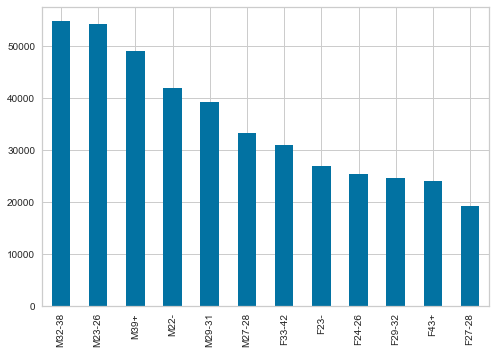

In [93]:
df_final_merged['group'].value_counts().plot(kind='bar');

**Q 2. Distribution of Users across Phone Brands(Consider only 10 Most used Phone Brands).**

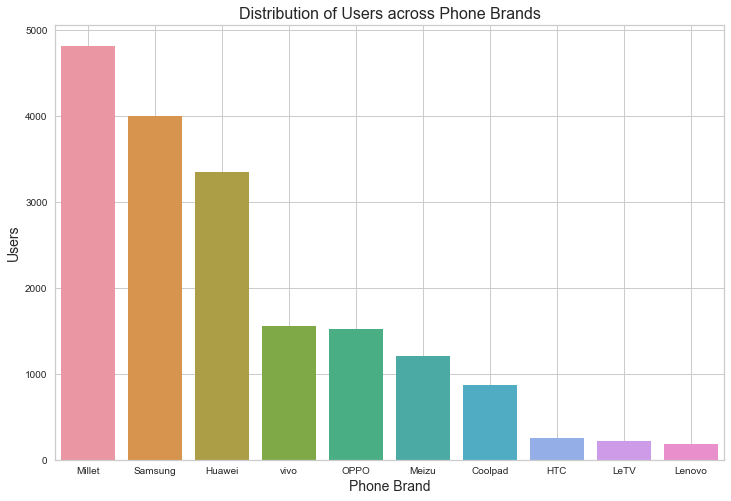

In [150]:
#df_final_merged['device_id'].nunique()
df_user_dist = df_final_merged[['device_id', 'phone_brand_en']]
df_user_dist = df_user_dist.drop_duplicates()
df_user_dist = df_user_dist.groupby('phone_brand_en',as_index=False).count().sort_values(by='device_id',ascending=False).head(10)

# Create a 15x7 inches figure
fig = plt.figure(figsize=(12, 8))

# Creating a barplot for Phone Brand vs Users
# plot barplot
ax = sns.barplot(x="phone_brand_en",
           y="device_id",           
           data=df_user_dist)
plt.xlabel("Phone Brand", size=14)
plt.ylabel("Users", size=14)
plt.title("Distribution of Users across Phone Brands", size=16)
plt.grid(b=True)
plt.show(ax)


<Figure size 864x576 with 0 Axes>

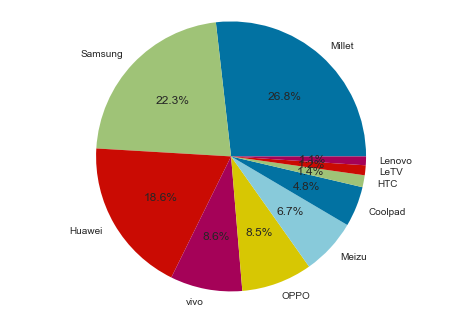

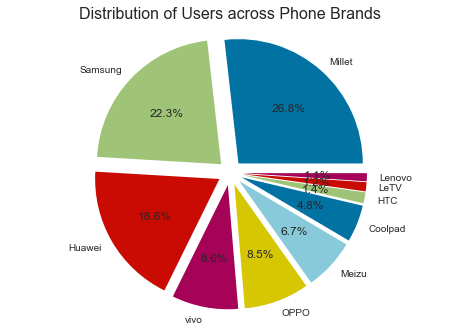

In [162]:
# Create a 15x7 inches figure
fig = plt.figure(figsize=(12, 8))

# Creating a barplot for Phone Brand vs Users
# plot barplot

fig1, ax = plt.subplots()
ax.pie(df_user_dist['device_id'], labels=df_user_dist['phone_brand_en'], autopct='%1.1f%%'     )
ax.axis('equal')

#Same chart with explode option
explode = (0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1)  
fig1, ax1 = plt.subplots()
ax1.pie(df_user_dist['device_id'], labels=df_user_dist['phone_brand_en'],explode=explode, autopct='%1.1f%%'     )
ax1.axis('equal')

plt.title("Distribution of Users across Phone Brands", size=16)
plt.grid(b=True)
plt.show(ax, ax1)


<a name = Section7></a>

---
# **7. Summarization**
---

<a name = Section71></a>
### **7.1 Conclusion**

<a name = Section72></a>
### **7.2 Actionable Insights**